# Annotation

## Automated annotation

For the automated annotation we will use manual "[Quering with the Human Lung Cell Atlas](https://docs.scvi-tools.org/en/stable/tutorials/notebooks/scrna/query_hlca_knn.html)"

In [1]:
import os
import tempfile

import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import scarches as sca
import scvi
import seaborn as sns
import torch
import harmonypy as hm
import matplotlib.pyplot as plt
from scvi.hub import HubModel
from pynndescent import NNDescent
from matplotlib.backends.backend_pdf import PdfPages
from scipy.sparse import csr_matrix
from scipy.sparse import hstack

scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)

data_path = "./data/"
graphics_path = "./graphics"

os.makedirs(f"{graphics_path}/Annotation", exist_ok=True)

 captum (see https://github.com/pytorch/captum).
INFO: Seed set to 0
INFO:lightning.fabric.utilities.seed:Seed set to 0


Last run with scvi-tools version: 1.2.2.post2


In [2]:
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

In [14]:
# Download and load the pre-trained scANVI model
hubmodel = HubModel.pull_from_huggingface_hub("scvi-tools/human-lung-cell-atlas-scanvi")
adata = hubmodel.adata
model = hubmodel.model

/tmp/ipykernel_6562/4223175319.py:2: UserWarning: No revision was passed, so the default (latest) revision will be used.
  hubmodel = HubModel.pull_from_huggingface_hub("scvi-tools/human-lung-cell-atlas-scanvi")


Fetching 3 files:   0%|          | 0/3 [00:00<?, ?it/s]

INFO     Reading adata...                                                                                          
INFO     No data found on disk. Skipping...                                                                        
INFO     Loading model...                                                                                          
INFO     File                                                                                                      
         /home/vera/.cache/huggingface/hub/models--scvi-tools--human-lung-cell-atlas-scanvi/snapshots/cdc082c0e69d8
         794602332b1cdb2de747c113442/model.pt already downloaded                                                   


/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scvi/data/fields/_dataframe_field.py:224: UserWarning: Category 18 in adata.obs['_scvi_labels'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scvi/data/fields/_scanvi.py:55: UserWarning: Category 18 in adata.obs['_scvi_labels'] has fewer than 3 cells. Models may not train properly.
  mapping = _make_column_categorical(


In [15]:
X_train = adata.obsm["scanvi_latent_qzm"]
ref_nn_index = NNDescent(X_train)
ref_nn_index.prepare()

In [19]:
data_path = "./data/"
adata_filtered = sc.read_h5ad(os.path.join(data_path, "adata_filtered.h5ad"))

sc.tl.leiden(adata_filtered, flavor="igraph", resolution=1.5)

adata_to_map = adata_filtered.copy()
for layer in list(adata_to_map.layers.keys()):
    if layer != "counts":
        del adata_to_map.layers[layer]
#adata_to_map.X = adata_to_map.layers["counts"]

adata_to_map.var["gene_names"] = adata_to_map.var.index

In [6]:
adata_filtered

AnnData object with n_obs × n_vars = 47542 × 33538
    obs: 'sample', 'n_counts', 'n_genes', 'Patient', 'Age', 'Sampling site', 'Sex', 'Cancer stage', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'percent_mito', 'doublet_score', 'predicted_doublet', 'leiden'
    var: 'gene_ids', 'feature_types', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'scrublet', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp

In [33]:
# clean up .var.index (gene names)
#adata_to_map.var["gene_names"] = adata_to_map.var.index
#adata_to_map.var.index = [idx.split("___")[-1] for idx in adata_to_map.var.gene_ids]
# clean up cell barcodes:
#adata_to_map.obs.index = adata_to_map.obs.index.str.rstrip("-1")

In [20]:
# 1. Prepare Query Dataset: query data must match the model

#    Ensure the query dataset's genes match the reference genes (by IDs, not gene names).
#    Provide batch labels to handle batch effects (we will use harmonypy).
#    Assign all query cells the label "unlabeled".

adata_to_map.var.index = adata_to_map.var['gene_ids']

adata_to_map.obs["scanvi_label"] = "unlabeled"

adata_to_map.obs["dataset"] = np.array([i.split(" ")[0] for i in adata_to_map.obs["sample"]])


In [21]:
adata_model = model.adata
print("Total number of genes needed for mapping:", adata_model.shape[1])

print("Number of genes found in query dataset:", adata_to_map.var.index.isin(adata_model.var.index).sum())

common_genes = adata_to_map.var.index.intersection(adata_model.var.index)

adata_to_map = adata_to_map[:, common_genes]

Total number of genes needed for mapping: 2000
Number of genes found in query dataset: 1993


In [22]:
adata_to_map

View of AnnData object with n_obs × n_vars = 47542 × 1993
    obs: 'sample', 'n_counts', 'n_genes', 'Patient', 'Age', 'Sampling site', 'Sex', 'Cancer stage', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'percent_mito', 'doublet_score', 'predicted_doublet', 'leiden', 'scanvi_label', 'dataset'
    var: 'gene_ids', 'feature_types', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'gene_names'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'scrublet', 'umap'
    obsm: 'X_pca', 'X

/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


286 highly variable genes identified.


/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/preprocessing/_pca.py:495: UserWarning: Ignoring auto and using arpack, sklearn.decomposition.PCA (with sparse input) only supports {'arpack', 'lobpcg'}
  warnings.warn(
2025-02-09 05:59:00,580 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
INFO:harmonypy:Computing initial centroids with sklearn.KMeans...
2025-02-09 05:59:09,403 - harmonypy - INFO - sklearn.KMeans initialization complete.
INFO:harmonypy:sklearn.KMeans initialization complete.
2025-02-09 05:59:09,811 - harmonypy - INFO - Iteration 1 of 500
INFO:harmonypy:Iteration 1 of 500
2025

Keys in obsm after Harmony: KeysView(AxisArrays with keys: X_pca, X_umap, X_pca_harmonize)
Shape of X_pca_harmonize: (47542, 15)


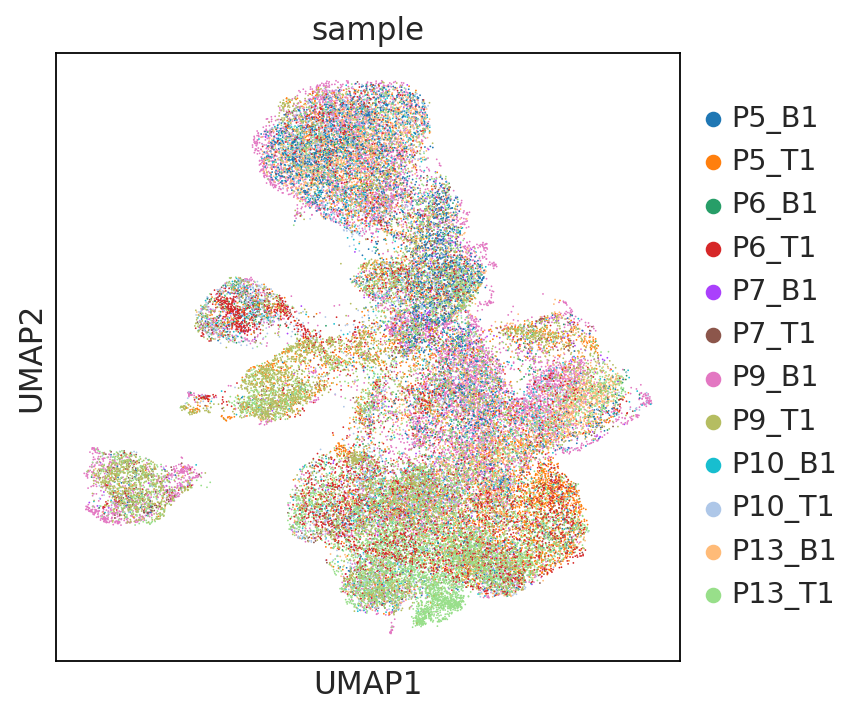

In [23]:
# Run harmony for batch correction

sc.pp.highly_variable_genes(adata_to_map, min_mean=0.00125, max_mean=3, min_disp=0.5, batch_key="sample")
print(adata_to_map.var['highly_variable'].sum(), "highly variable genes identified.")

sc.tl.pca(adata_to_map, n_comps=50, svd_solver='auto', use_highly_variable=True)

ho = hm.run_harmony(
    adata_to_map.obsm['X_pca'][:, :15],
    adata_to_map.obs,
    ["sample"],
    max_iter_kmeans=25,
    max_iter_harmony=500
)

adata_to_map.obsm["X_pca_harmonize"] = ho.Z_corr.T
print("Keys in obsm after Harmony:", adata_to_map.obsm.keys())
print("Shape of X_pca_harmonize:", adata_to_map.obsm["X_pca_harmonize"].shape)

sc.pp.neighbors(
    adata_to_map,
    n_pcs=adata_to_map.obsm["X_pca_harmonize"].shape[1],
    use_rep="X_pca_harmonize"
)

sc.tl.umap(adata_to_map)
sc.pl.umap(adata_to_map, color=["sample"])


In [24]:
adata_to_map.write(os.path.join(data_path, "adata_harmonised_to_map.h5ad"))

In [25]:
# Prepare the query dataset:

#    Missing genes are added with counts set to 0.
#    The order of genes is adjusted to match the reference.

scvi.model.SCANVI.prepare_query_anndata(adata_to_map, model, return_reference_var_names=True)


Index(['ENSG00000000938', 'ENSG00000000971', 'ENSG00000002587',
       'ENSG00000002933', 'ENSG00000003436', 'ENSG00000004776',
       'ENSG00000004799', 'ENSG00000004838', 'ENSG00000005448',
       'ENSG00000005844',
       ...
       'ENSG00000277639', 'ENSG00000277734', 'ENSG00000278002',
       'ENSG00000278196', 'ENSG00000279576', 'ENSG00000280721',
       'ENSG00000281103', 'ENSG00000282122', 'ENSG00000282988',
       'ENSG00000283063'],
      dtype='object', length=2000)

In [26]:
missing_genes = [
    gene_id
    for gene_id in model.adata.var_names
    if gene_id not in adata_to_map.var.index
]
print(missing_genes)

missing_gene_adata = sc.AnnData(
    X=csr_matrix(np.zeros(shape=(adata_to_map.n_obs, len(missing_genes))), dtype="float32"),
    obs=adata_to_map.obs.iloc[:, :1],  # Make sure to copy the observations (e.g., cells)
    var=model.adata.var.loc[missing_genes])  # Use .loc[] to filter the var dataframe for missing genes

missing_gene_adata.layers["counts"] = missing_gene_adata.X
missing_gene_adata

['ENSG00000231721', 'ENSG00000236824', 'ENSG00000253701', 'ENSG00000267453', 'ENSG00000269936', 'ENSG00000274961', 'ENSG00000279576']


AnnData object with n_obs × n_vars = 47542 × 7
    obs: 'sample'
    var: 'feature_name', 'feature_length', 'cv_gene_ratio'
    layers: 'counts'

In [27]:
if "PCs" in adata_to_map.varm.keys():
    del adata_to_map.varm["PCs"]

adata_to_map = sc.concat(
    [adata_to_map, missing_gene_adata],
    axis=1,
    join="outer",
    index_unique=None,
    merge="unique",
)


In [28]:
adata_to_map.write(os.path.join(data_path, "adata_harmonised_to_map.h5ad"))

In [7]:
adata_to_map = sc.read_h5ad(os.path.join(data_path, "adata_harmonised_to_map.h5ad"))

In [8]:
adata_to_map

AnnData object with n_obs × n_vars = 47542 × 2000
    obs: 'sample', 'n_counts', 'n_genes', 'Patient', 'Age', 'Sampling site', 'Sex', 'Cancer stage', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'percent_mito', 'doublet_score', 'predicted_doublet', 'leiden', 'scanvi_label', 'dataset'
    var: 'gene_ids', 'feature_types', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'gene_names', 'feature_name', 'feature_length', 'cv_gene_ratio'
    obsm: 'X_pca', 'X_pca_harmonize', 'X_umap'
    layers: 'counts'
    obsp: 'connectivit

In [12]:
# 2. Train the model on the query dataset

scvi.model.SCVI.prepare_query_anndata(adata_to_map, model, return_reference_var_names=True)

adata_to_map = adata_to_map.copy()
query_model = scvi.model.SCANVI.load_query_data(adata_to_map, model)

surgery_epochs = 500
train_kwargs_surgery = {
    "early_stopping": True,
    "early_stopping_monitor": "elbo_train",
    "early_stopping_patience": 10,
    "early_stopping_min_delta": 0.001,
    "plan_kwargs": {"weight_decay": 0.0},
}

query_model.train(max_epochs=surgery_epochs, **train_kwargs_surgery)

#query_model.train(
#    max_epochs=500,
#    early_stopping=True,
#    early_stopping_monitor="elbo_train",
#    early_stopping_patience=10,
#    early_stopping_min_delta=0.001)


INFO     Training for 500 epochs.                                                                                  


/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scvi/model/base/_archesmixin.py:105: UserWarning: `var_names` for the loaded `adata` does not match those of the `adata` used to train the model. For valid results, the former should match the latter.
  _validate_var_names(adata, var_names)
/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scvi/model/base/_archesmixin.py:110: UserWarning: `var_names` for the loaded `adata` does not match those of the `adata` used to train the model. For valid results, the former should match the latter.
  _validate_var_names(adata, var_names)
/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scvi/data/fields/_base_field.py:63: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)
INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 T

Training:   0%|          | 0/500 [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=500` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=500` reached.


In [13]:
# Save the model
query_model_path = os.path.join(data_path, "HLCA_model")
query_model.save(query_model_path, overwrite=True)

In [ ]:
# Load the model

# Load associated AnnData object
#adata_to_map = anndata.read_h5ad(os.path.join(data_path, "adata_harmonised_to_map.h5ad"))

# Load the SCANVI model
#query_model = scvi.model.SCANVI.load(os.path.join(data_path, "HLCA_model"), adata=adata_to_map)

INFO     File ./data/HLCA_model/model.pt already downloaded                                                        


/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scvi/data/fields/_base_field.py:63: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


In [29]:
# 3. Generate latent representations: the query dataset is embedded into the same latent space as the reference dataset.

query_emb = anndata.AnnData(query_model.get_latent_representation())
query_emb.obs_names = adata_to_map.obs_names

# Get the latent representation of the reference data
ref_latent = model.get_latent_representation()
ref_nn_index = NNDescent(ref_latent, metric="euclidean", n_neighbors=15)

# Same for the query dataset

query_latent = query_model.get_latent_representation()
ref_neighbors, ref_distances = ref_nn_index.query(query_latent)

In [30]:
# Label transfer 

query_emb.var["original_gene_ids"] = query_emb.var_names

stds = np.std(ref_distances, axis=1)
stds = (2.0 / stds) ** 2
stds = stds.reshape(-1, 1)
ref_distances_tilda = np.exp(-np.true_divide(ref_distances, stds))
weights = ref_distances_tilda / np.sum(ref_distances_tilda, axis=1, keepdims=True)

def weighted_prediction(weights, ref_cats):
    """Get highest weight category."""
    N = len(weights)
    predictions = np.zeros((N,), dtype=ref_cats.dtype)
    uncertainty = np.zeros((N,))
    for i in range(N):
        obs_weights = weights[i]
        obs_cats = ref_cats[i]
        best_prob = 0
        for c in np.unique(obs_cats):
            cand_prob = np.sum(obs_weights[obs_cats == c])
            if cand_prob > best_prob:
                best_prob = cand_prob
                predictions[i] = c
                uncertainty[i] = max(1 - best_prob, 0)

    return predictions, uncertainty

label_keys = [f"ann_level_{i}" for i in range(1, 6)] + ["ann_finest_level"]

for l in label_keys:
    ref_cats = adata.obs[l].cat.codes.to_numpy()[ref_neighbors]
    p, u = weighted_prediction(weights, ref_cats)
    p = np.asarray(adata.obs[l].cat.categories)[p]
    query_emb.obs[l + "_pred"], query_emb.obs[l + "_uncertainty"] = p, u

In [31]:
# 4. Filter uncertain predictions: cells with high uncertainty are marked as "Unknown".

uncertainty_threshold = 0.2
for l in label_keys:
    mask = query_emb.obs[l + "_uncertainty"] > uncertainty_threshold
    query_emb.obs[l + "_pred"].loc[mask] = "Unknown"

/tmp/ipykernel_6562/1786197385.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  query_emb.obs[l + "_pred"].loc[mask] = "Unknown"
/tmp/ipykernel_6562/1786197385.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

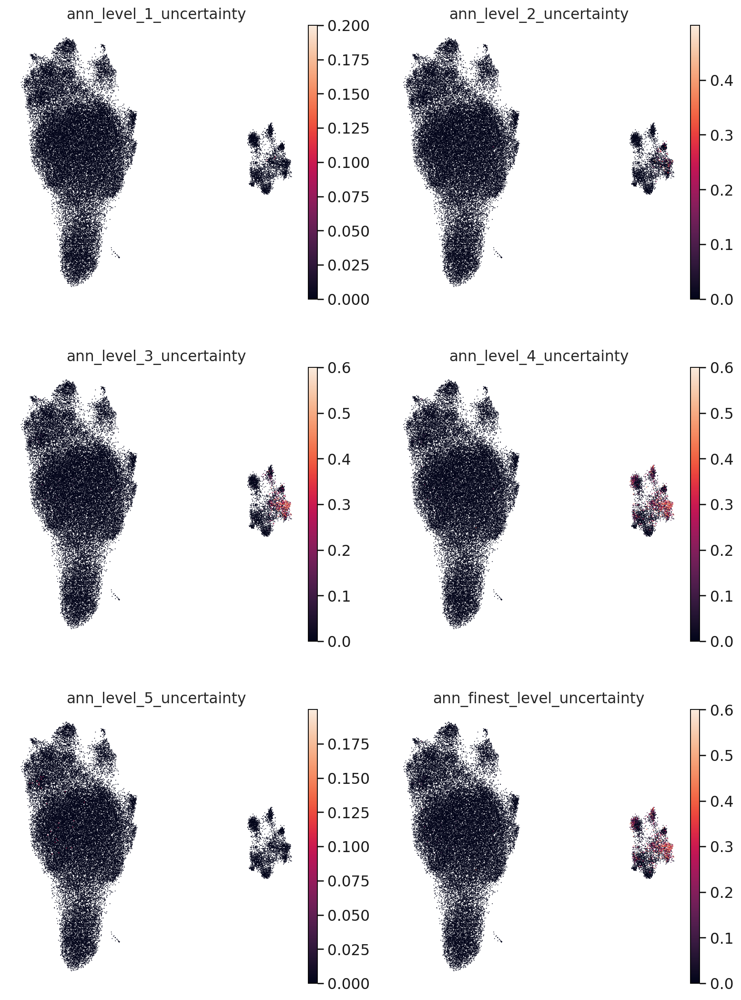

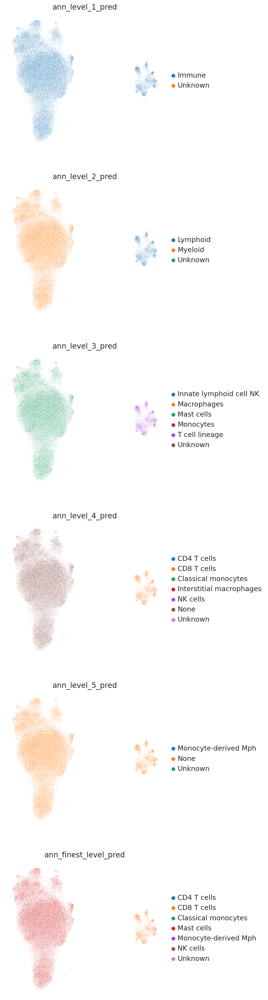

In [32]:
#Visualize with UMAP

LATENT_KEY = "X_scanVI"
query_emb.obsm[LATENT_KEY] = query_emb.X

sc.pp.neighbors(query_emb, use_rep=LATENT_KEY)
sc.tl.umap(query_emb, min_dist=0.3)

colors = [l + "_uncertainty" for l in label_keys]
sc.pl.umap(query_emb, color=colors, ncols=2, frameon=False)

uncertainty_threshold = 0.2
for l in label_keys:
    if "Unknown" not in query_emb.obs[l + "_pred"].cat.categories:
        query_emb.obs[l + "_pred"] = query_emb.obs[l + "_pred"].cat.add_categories(["Unknown"])
    
    mask = query_emb.obs[l + "_uncertainty"] > uncertainty_threshold
    query_emb.obs.loc[mask, l + "_pred"] = "Unknown"


colors = [l + "_pred" for l in label_keys]
sc.pl.umap(query_emb, color=colors, ncols=1, size=0.5, frameon=False)


<Axes: title={'center': 'Automated Annotation Prediction'}, xlabel='UMAP1', ylabel='UMAP2'>

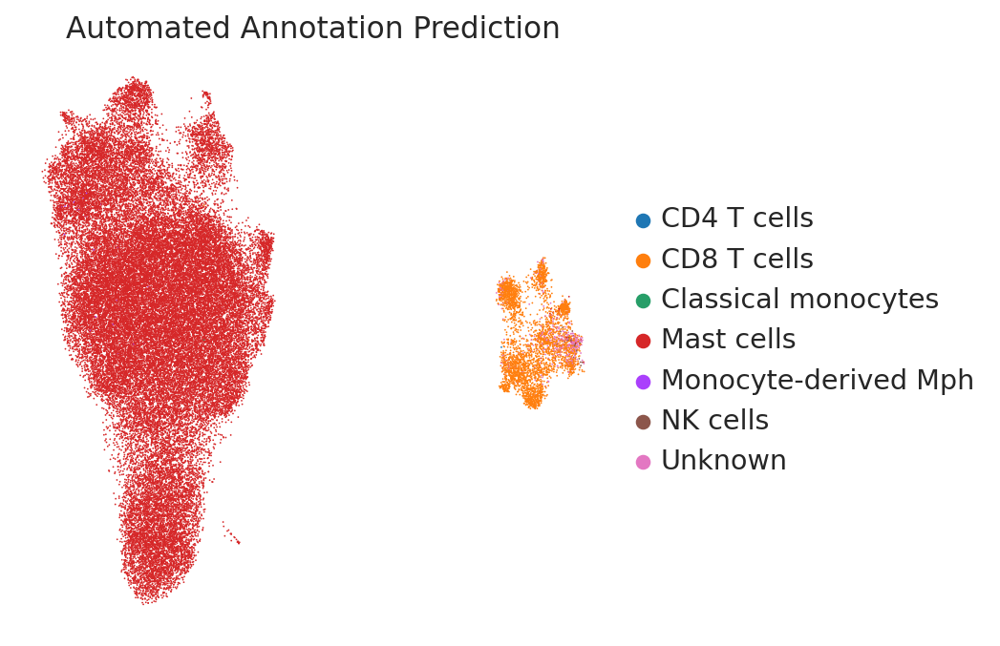

In [33]:
sc.pl.umap(
    query_emb, 
    color="ann_finest_level_pred", 
    frameon=False, 
    show=False,
    title="Automated Annotation Prediction")


In [19]:
query_emb.write(os.path.join(data_path, "annotated_data.h5ad"))

In [ ]:
#query_emb = sc.read_h5ad(os.path.join(data_path, "annotated_data.h5ad"))

In [34]:
ref_emb = anndata.AnnData(X_train, obs=adata.obs)
print(ref_emb)

#We’ll store a variable specifying that these cells are from the reference.

ref_emb.obs["reference_or_query"] = "reference"

#combined_emb = ref_emb.concatenate(query_emb)

AnnData object with n_obs × n_vars = 584944 × 30
    obs: 'suspension_type', 'donor_id', 'is_primary_data', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'tissue_ontology_term_id', 'organism_ontology_term_id', 'sex_ontology_term_id', 'BMI', 'age_or_mean_of_age_range', 'age_range', 'anatomical_region_ccf_score', 'ann_coarse_for_GWAS_and_modeling', 'ann_finest_level', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'cause_of_death', 'dataset', 'entropy_dataset_leiden_3', 'entropy_original_ann_level_1_leiden_3', 'entropy_original_ann_level_2_clean_leiden_3', 'entropy_original_ann_level_3_clean_leiden_3', 'entropy_subject_ID_leiden_3', 'fresh_or_frozen', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'leiden_5', 'log10_total_counts', 'lung_condition', 'mixed_ancestry', 'n_genes_detected', 'original_ann_highest_res', 'original_ann_level_1', 'ori

In [35]:

#Let’s perform the KNN-based label transfer.

#First we set up the label transfer model:

knn_transformer = sca.utils.knn.weighted_knn_trainer(
    train_adata=ref_emb,
    train_adata_emb="X",  # location of our joint embedding
    n_neighbors=15,
)

# Now we perform the label transfer:

labels, uncert = sca.utils.knn.weighted_knn_transfer(
    query_adata=query_emb,
    query_adata_emb="X",  # location of our embedding, query_adata.X in this case
    label_keys="cell_type",  # (start of) obs column name(s) for which to transfer labels
    knn_model=knn_transformer,
    ref_adata_obs=ref_emb.obs,
)



Weighted KNN with n_neighbors = 15 ... 

/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scarches/utils/knn.py:130: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  uncertainties.iloc[i][j] = (max(1 - best_prob, 0))
/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-

finished!


In [36]:
adata_filtered.obs.loc[query_emb.obs.index, "transf_cell_type"] = query_emb.obs["ann_finest_level_pred"]
adata_filtered.obs.loc[query_emb.obs.index, "transf_cell_type_unc"] = query_emb.obs["ann_finest_level_uncertainty"]

In [37]:
#Let’s transfer the results to our query adata object which also has our UMAP and gene counts, so that we can visualize all of those together.

#adata_to_map.obs.loc[query_emb.obs.index, "transf_cell_type"] = query_emb.obs["transf_cell_type"]
#adata_to_map.obs.loc[query_emb.obs.index, "transf_cell_type_unc"] = query_emb.obs["transf_cell_type_unc"]

#We can now visualize the transferred labels in our previously calculated UMAP of our own data:

#Let’s set the figure size smaller again:
# Calculate neighbors (if not done already)
sc.pp.neighbors(adata_filtered, n_neighbors=15, n_pcs=50)

# Compute UMAP
sc.tl.umap(adata_filtered)

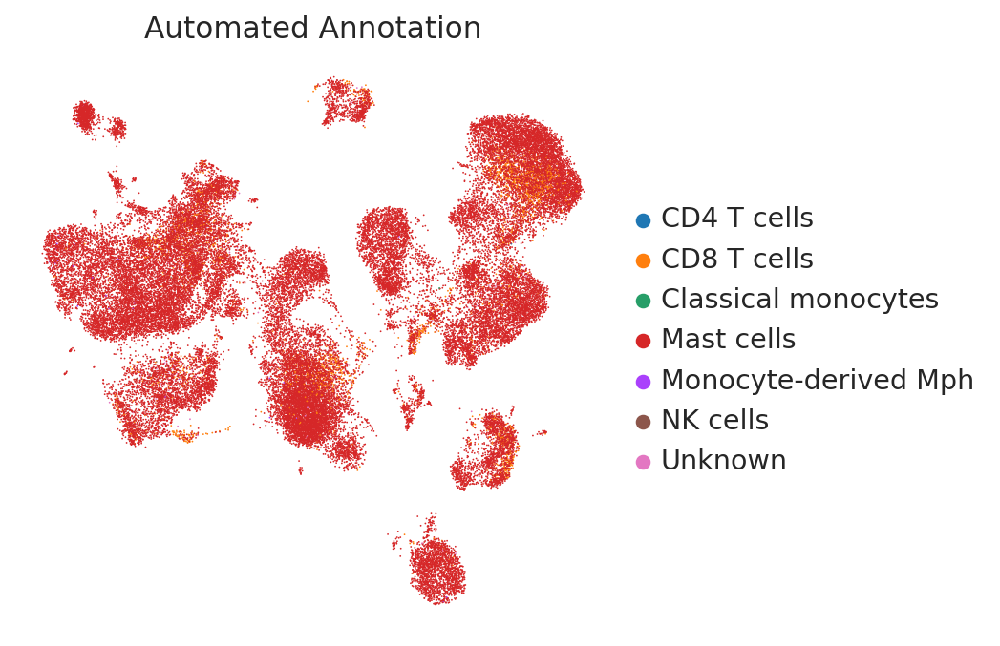

<Figure size 400x400 with 0 Axes>

In [38]:

sc.set_figure_params(figsize=(5, 5))

output_path = os.path.join(graphics_path, "Annotation", "Automated_annotation1.pdf")

with PdfPages(output_path) as pdf:
    fig, ax = plt.subplots()
    sc.pl.umap(
        adata_filtered,
        color="transf_cell_type",
        frameon=False,
        title="Automated Annotation",
        ax=ax)
    
    plt.tight_layout()
    pdf.savefig(fig)
    plt.close(fig)

In [39]:
adata_filtered.write(os.path.join(data_path, "adata_auto_annotated.h5ad"))

In [ ]:
#adata_filtered = sc.read_h5ad(os.path.join(data_path, "adata_auto_annotated.h5ad"))

## Manual Annotaion

For manual annotation, we will use table with marker genes from the Human Lung Cell Atlas (Supplementary Table 6).

The table can be dowloaded [here](https://static-content.springer.com/esm/art%3A10.1038%2Fs41591-023-02327-2/MediaObjects/41591_2023_2327_MOESM3_ESM.xlsx)

In [40]:
# Read the sheet
marker_data = pd.read_excel("41591_2023_2327_MOESM3_ESM.xlsx", sheet_name = "6 - marker genes")
marker_data = marker_data.drop(marker_data.columns[0],axis=1)
marker_data.columns = marker_data.iloc[0]
marker_data = marker_data[1:] 

cell_type_markers = {}

for col_index in range(0, marker_data.shape[1], 3):
    col_name = marker_data.columns[col_index] 
    markers = marker_data[col_name].dropna().tolist()
    cell_type_markers[col_name] = markers


with open("cell_type_markers.txt", "w") as file:
    for cell_type, markers in cell_type_markers.items():
        file.write(f"{cell_type}:\n")
        file.write(", ".join(markers) + "\n\n")


In [41]:
gene_names_set = set(adata_to_map.var.gene_names)

marker_genes_in_data = dict()

for ct, markers in cell_type_markers.items():
    markers_found = list()
    for marker in markers:
        if marker in gene_names_set:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found

print(marker_genes_in_data)



{'AT0_marker': ['FXYD3', 'EPCAM', 'ELF3', 'IGFBP2', 'SERPINF1', 'TSPAN1', 'SFTPB', 'SCGB3A2', 'SFTA2'], 'AT1_marker': ['FXYD3', 'EPCAM', 'ELF3', 'HOPX', 'SFTA2', 'SLC39A8', 'CLIC5', 'SPOCK2', 'TIMP3'], 'AT2 proliferating_marker': ['FXYD3', 'EPCAM', 'ELF3', 'HOPX', 'SFTA2', 'SLC39A8'], 'AT2_marker': ['FXYD3', 'EPCAM', 'ELF3', 'HOPX', 'SFTA2', 'SLC39A8', 'MFSD2A', 'C11orf96'], 'Adventitial fibroblasts_marker': ['COL1A2', 'DCN', 'MFAP4', 'LUM', 'COL6A3', 'CFD', 'MFAP5', 'SCARA5', 'PI16'], 'Alveolar Mph CCL3+_marker': ['CD53', 'PTPRC', 'CORO1A', 'FCER1G', 'C1orf162', 'CCL20'], 'Alveolar Mph MT-positive_marker': ['CD53', 'PTPRC', 'CORO1A', 'FCER1G', 'C1orf162', 'MT1M', 'CCL18', 'MT1E'], 'Alveolar Mph proliferating_marker': ['CD53', 'PTPRC', 'CORO1A', 'FCER1G', 'C1orf162', 'TYMS'], 'Alveolar fibroblasts_marker': ['COL1A2', 'DCN', 'MFAP4', 'LUM', 'COL6A3', 'CFD', 'FGFR4'], 'Alveolar macrophages_marker': ['CD53', 'PTPRC', 'CORO1A', 'FCER1G', 'C1orf162', 'CYP27A1', 'MARCO', 'FABP4'], 'B cells_m

In [42]:
cell_types_to_plot = [
    "AT1_marker", "AT2_marker", "AT2_proliferating_marker", "CD4 T cells_marker",
    "CD8 T cells_marker", "Alveolar fibroblasts_marker", "Alveolar macrophages_marker",
    "Alveolar Mph CCL3+_marker", "Alveolar Mph MT-positive_marker", "Alveolar Mph proliferating_marker", "Alveolar macrophages_marker",
    "B cells_marker", "Basal resting_marker", "DC1_marker", "DC2_marker", "Mast cells_marker", "NK cells_marker", "SM activated stress response_marker"
]

marker_genes_in_data = {
    key: value for key, value in marker_genes_in_data.items()
    if key in cell_types_to_plot
}

print(marker_genes_in_data)

output_pdf = os.path.join(graphics_path, "Annotation", "HLCA_Cell_Type_Markers_UMAP_Manual.pdf")

with PdfPages(output_pdf) as pdf:
    for cell_type, genes in marker_genes_in_data.items():
        for gene in genes:
            if gene not in adata_filtered.var.index:
                print(f"Gene {gene} not found in dataset. Skipping...")
                continue

            sc.pl.umap(
                adata_filtered,
                color=gene,
                frameon=False,
                title=f"{gene} Expression in {cell_type}",
                show=False
            )

            # Add cluster numbers
            umap_coords = adata_filtered.obsm["X_umap"]
            clusters = adata_filtered.obs["leiden"]
            cluster_centers = np.array([
                umap_coords[clusters == cluster].mean(axis=0)
                for cluster in sorted(clusters.unique())
            ])

            fig = plt.gcf()
            ax = plt.gca()
            for cluster, (x, y) in zip(sorted(clusters.unique()), cluster_centers):
                ax.text(
                    x, y, str(cluster),
                    color="black",
                    fontsize=12,
                    ha="center",
                    va="center",
                    bbox=dict(facecolor="white", alpha=0.7, edgecolor="none"))

            plt.tight_layout()
            pdf.savefig(fig)
            plt.close(fig)

print(f"UMAP plots saved to {output_pdf}")

{'AT1_marker': ['FXYD3', 'EPCAM', 'ELF3', 'HOPX', 'SFTA2', 'SLC39A8', 'CLIC5', 'SPOCK2', 'TIMP3'], 'AT2_marker': ['FXYD3', 'EPCAM', 'ELF3', 'HOPX', 'SFTA2', 'SLC39A8', 'MFSD2A', 'C11orf96'], 'Alveolar Mph CCL3+_marker': ['CD53', 'PTPRC', 'CORO1A', 'FCER1G', 'C1orf162', 'CCL20'], 'Alveolar Mph MT-positive_marker': ['CD53', 'PTPRC', 'CORO1A', 'FCER1G', 'C1orf162', 'MT1M', 'CCL18', 'MT1E'], 'Alveolar Mph proliferating_marker': ['CD53', 'PTPRC', 'CORO1A', 'FCER1G', 'C1orf162', 'TYMS'], 'Alveolar fibroblasts_marker': ['COL1A2', 'DCN', 'MFAP4', 'LUM', 'COL6A3', 'CFD', 'FGFR4'], 'Alveolar macrophages_marker': ['CD53', 'PTPRC', 'CORO1A', 'FCER1G', 'C1orf162', 'CYP27A1', 'MARCO', 'FABP4'], 'B cells_marker': ['CD53', 'PTPRC', 'CORO1A', 'MS4A1'], 'Basal resting_marker': ['FXYD3', 'EPCAM', 'ELF3', 'IGFBP2', 'SERPINF1', 'TSPAN1', 'KRT15', 'KRT17'], 'CD4 T cells_marker': ['CD53', 'PTPRC', 'CORO1A', 'ISG20', 'CCL5', 'CD40LG', 'TNFRSF25', 'CD28', 'TRAT1'], 'CD8 T cells_marker': ['CD53', 'PTPRC', 'CORO

In [11]:
#11.4.2. From cluster differentially expressed genes to cluster annotation

#Conversely, we can calculate marker genes per cluster and then look up whether we can link those marker genes to any known biology such as cell types and/or states. For marker gene calculation of clusters simple methods such as the Wilcoxon rank-sum test are thought to perform best [Pullin and McCarthy, 2022]. Importantly, as the definition of the clusters is based on the same data as used for these statistical tests, the p-values of these tests will be inflated as also described here [Zhang et al., 2019].

#Let’s calculate the differentially expressed genes for every cluster, compared to the rest of the cells in our adata:

#sc.tl.leiden(adata_filtered, resolution=1.5, flavor="igraph", key_added="leiden_2")

sc.tl.rank_genes_groups(adata_filtered, groupby="leiden", method="wilcoxon", key_added="rank_genes_groups_leiden")

/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:429: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:431: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/vera/miniforge3/envs/scanpy/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:434: Performanc

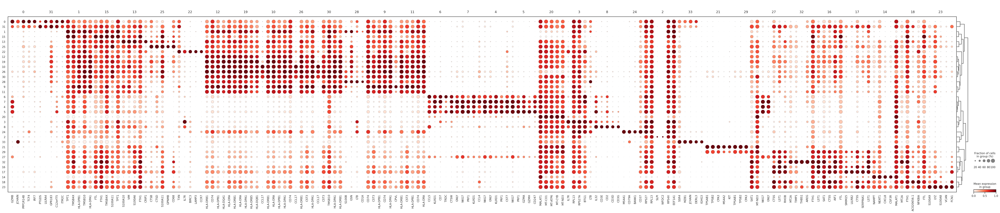

In [12]:
sns.set_theme(style="white")

sc.pl.rank_genes_groups_dotplot(
    adata_filtered,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="rank_genes_groups_leiden",
    #gene_symbols="gene_names",
    )


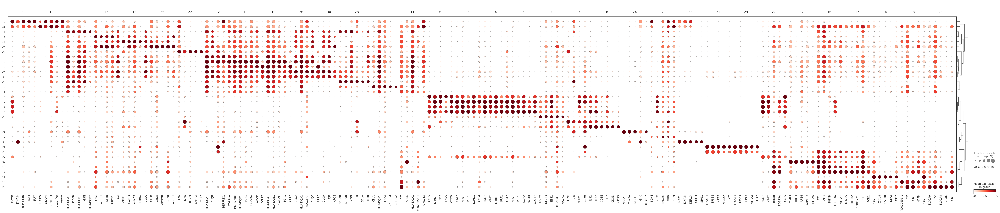

In [13]:

sc.tl.filter_rank_genes_groups(
    adata_filtered,
    min_in_group_fraction=0.3,
    key="rank_genes_groups_leiden",
    key_added="rank_genes_groups_leiden_filtered"
)


fig = sc.pl.rank_genes_groups_dotplot(
    adata_filtered,
    groupby="leiden",
    standard_scale="var",
    n_genes=5,
    key="rank_genes_groups_leiden_filtered",
    #gene_symbols="gene_names",
    return_fig=True)

output_path = os.path.join(graphics_path, "Annotation", "rank_genes_for_clusters.pdf")
fig.savefig(output_path)


In [48]:
# Extract top genes for each cluster from the figure

ranked_genes = adata_filtered.uns['rank_genes_groups_leiden_filtered']

top_genes_by_cluster = {}

for cluster in ranked_genes['names'].dtype.names:
    top_genes = [gene for gene in ranked_genes['names'][cluster] if pd.notna(gene)][:20]
    #gene_symbols = [
    #    adata_filtered.var.loc[gene, 'gene_names'] if gene in adata_filtered.var.index else gene 
    #    for gene in top_genes
    #]
    top_genes_by_cluster[cluster] = top_genes

for cluster, genes in top_genes_by_cluster.items():
    print(f"Cluster {cluster}: {genes}")

Cluster 0: ['GZMB', 'JCHAIN', 'PPP1R14B', 'TCF4', 'IRF7', 'ITM2C', 'UGCG', 'SEC61B', 'LILRA4', 'IRF8', 'BCL11A', 'IGKC', 'MZB1', 'IL3RA', 'CCDC50', 'TSPAN13', 'PLD4', 'SERPINF1', 'SMPD3', 'APP']
Cluster 1: ['HLA-DQA1', 'S100B', 'HLA-DQB1', 'GSN', 'HLA-DQB2', 'PPA1', 'PKIB', 'YWHAH', 'MS4A6A', 'SPI1', 'ALDH2', 'CTSH', 'C1QC', 'C15orf48', 'C1QA', 'GDI2', 'RGS10', 'C1QB', 'FCER1A', 'NDRG2']
Cluster 2: ['SOX4', 'HOPX', 'PRDX5', 'LDHB', 'DSTN', 'TSTD1', 'EZR']
Cluster 3: ['IL7R', 'LTB', 'KLRB1', 'CD69', 'IL32', 'TRAC', 'SPOCK2', 'PIK3IP1', 'ETS1', 'TNFRSF18', 'CD96', 'TRBC2', 'TRBC1', 'CD7', 'TNFRSF25', 'TNFRSF4', 'TNFAIP3', 'TCF7', 'CD2', 'AAK1']
Cluster 4: ['NKG7', 'GNLY', 'KLRD1', 'PRF1', 'CST7', 'GZMB', 'GZMA', 'FGFBP2', 'CCL5', 'KLRB1', 'SPON2', 'CD247', 'KLRF1', 'ETS1', 'CTSW', 'CD7', 'CCL4', 'GZMH', 'GZMM', 'CLIC3']
Cluster 5: ['NKG7', 'PRF1', 'GZMA', 'GZMH', 'CD247', 'CCL5', 'GNLY', 'FGFBP2', 'CST7', 'IL32', 'KLRD1', 'CTSW', 'GZMB', 'TRDC', 'TRBC1', 'KLRF1', 'CCL4', 'CD99', 'ABHD17A

In [ ]:

reference_cell_type_markers = {
    "AT0": ["FXYD3", "EPCAM", "ELF3", "IGFBP2", "SERPINF1", "TSPAN1", "SFTPB", "SCGB3A2", "SFTA2"],
    "AT1": ["FXYD3", "EPCAM", "ELF3", "HOPX", "SFTA2", "SLC39A8", "CLIC5", "SPOCK2", "TIMP3"],
    "AT2_proliferating": ["FXYD3", "EPCAM", "ELF3", "HOPX", "SFTA2", "SLC39A8", "CENPW", "CDKN3", "BIRC5"],
    "AT2": ["FXYD3", "EPCAM", "ELF3", "HOPX", "SFTA2", "SLC39A8", "MFSD2A", "C8orf4", "C11orf96"],

    # Fibroblasts
    "Adventitial_fibroblasts": ["COL1A2", "DCN", "MFAP4", "LUM", "COL6A3", "CFD", "MFAP5", "SCARA5", "PI16"],
    "Alveolar_fibroblasts": ["COL1A2", "DCN", "MFAP4", "LUM", "COL6A3", "CFD", "SPINT2", "LIMCH1", "FGFR4"],
    "Myofibroblasts": ["COL1A2", "DCN", "MFAP4", "LUM", "COL6A3", "CFD", "LMOD1", "ATP1B1", "TYRP1"],
    "Subpleural_fibroblasts": ["COL1A2", "DCN", "MFAP4", "LUM", "COL6A3", "CFD", "MARCKSL1", "APOC1", "MMP23B"],
    "Peribronchial_fibroblasts": ["COL1A2", "DCN", "MFAP4", "LUM", "COL6A3", "CFD", "COL15A1", "CXCL14", "DIO2"],

    # Macrophages
    "Alveolar_Mph_CCL3+": ["CD53", "PTPRC", "CORO1A", "FCER1G", "C1orf162", "CLEC7A", "CCL20", "FAM89A"],
    "Alveolar_Mph_MT_positive": ["CD53", "PTPRC", "CORO1A", "FCER1G", "C1orf162", "CLEC7A", "MT1M", "CCL18", "MT1E"],
    "Alveolar_Mph_proliferating": ["CD53", "PTPRC", "CORO1A", "FCER1G", "C1orf162", "CLEC7A", "TYMS", "CENPW", "MND1"],
    "Alveolar_macrophages": ["CD53", "PTPRC", "CORO1A", "FCER1G", "C1orf162", "CLEC7A", "CYP27A1", "MARCO", "FABP4"],
    "Anti-inflammatory_Mph": ["C1QB", "C1QC", "APOE", "MRC1", "MARCO"],
    "Monocyte_derived_Mph": ["CD53", "PTPRC", "CORO1A", "FCER1G", "C1orf162", "CLEC7A", "SPP1", "HAMP"],
    "STAB1+_Mph": ["STAB1", "APOE", "C1QC", "MARCO"],
    "CAMLs (Cancer-associated macrophage-like cells)": ["KRT18", "KRT19", "EPCAM", "LYZ", "SPI2", "CD14", "CD163", "C1QC", "APOE"],

    # Monocytes
    "Classical_monocytes": ["CD53", "PTPRC", "CORO1A", "FCER1G", "C1orf162", "CLEC7A", "S100A12", "FCN1", "RNASE2"],
    "Non_classical_monocytes": ["CD53", "PTPRC", "CORO1A", "FCER1G", "C1orf162", "CLEC7A", "MTSS1", "LILRA5", "FCN1"],

    # T cells
    "CD4_T_cells": ["CD53", "PTPRC", "CORO1A", "ISG20", "CCL5", "CD40LG", "TNFRSF25", "CD28", "CD4", "TRAT1"],
    "CD8_T_cells": ["CD53", "PTPRC", "CORO1A", "ISG20", "CCL5", "CD8A", "CD8B", "TRGC2"],
    "Exhausted_T_cells": ["TIGIT", "CTLA4", "PDCD1", "LAG3", "CXCL13"],
    "Tregs": ["FOXP3", "CTLA4", "TNFRSF18"],

    # NK cells
    "NK_cells_high_cytotoxic": ["NKG7", "PRF1", "GZMA", "GZMB", "GZMM", "GZMK", "KLRB1"],
    "NK_cells_low_cytotoxic": ["NKG7", "PRF1", "KLRB1"],

    # B cells
    "B_cells": ["CD53", "PTPRC", "CORO1A", "MS4A1"],
    "Mature_B_cells": ["CD79A", "CD79B", "IGHM"],
    "Plasma_B_cells": ["JCHAIN", "IGHG1", "IGKC", "IGHA1", "XBP1", "MZB1"],
    "Cycling_B_cells": ["MKI67", "TOP2A"],

    # Dendritic cells (DC)
    "DC1": ["CD53", "PTPRC", "CORO1A", "XCR1", "CLEC9A", "CLNK"],
    "DC2": ["CD53", "PTPRC", "CORO1A", "FCER1G", "C1orf162", "CLEC7A", "PKIB", "CLEC10A", "CD1E"],
    "mo-DC2": ["CD14", "CD163", "MRC1"],

    # Epithelial cells
    "Epithelial_cells": ["EPCAM", "CDH1", "KRT18", "KRT19"],
    "AT2_cells": ["SFTPB", "MUC1", "SFTPC"],
    "Cycling_AT2_cells": ["SFTPB", "MUC1", "SFTPC", "MKI67", "TOP2A"],

    # Other cells
    "Mast_cells": ["HDC", "MITF", "GATA2"],
    "Cycling_Mast_cells": ["HDC", "MITF", "GATA2", "MKI67", "TOP2A"],
    "Lymphatic_endothelial_cells": ["CLDN5", "PECAM1", "RAMP2", "CCL21", "LYVE1"],
    "Monocytes_general": ["CD14", "IL1B", "FCN1", "CXCL8", "S100A8", "S100A9"],
    "Macrophages_general": ["CD14", "CD163", "CD68", "MARCO", "MRC1"],
    "Anti-inflammatory_Macrophages": ["C1QB", "C1QC", "APOE", "MRC1", "MARCO"],
    "T_cells_general": ["TRAC", "CD3D", "CD3E", "CD3G"],
    "Exhausted_T_cells": ["TIGIT", "CTLA4", "PDCD1", "LAG3", "CXCL13"],
    "Regulatory_T_cells": ["FOXP3", "CTLA4", "TNFRSF18"],
    "NK_cells_general": ["NKG7", "PRF1", "GZMA", "GZMB", "GZMK", "KLRB1"],
    "Non_immune_cells": ["EPCAM", "CDH1", "KRT18", "KRT19"],
}

results = []


for cluster_name, expressed_genes in top_genes_by_cluster.items():
    best_match = None
    max_hits = 0
    overlapping_genes = []

    for cell_type, signature_genes in reference_cell_type_markers.items():
        intersection = set(expressed_genes) & set(signature_genes)
        num_hits = len(intersection)

        # Check if the current cell type has more hits than the previous best match
        if num_hits > max_hits:
            best_match = cell_type
            max_hits = num_hits
            overlapping_genes = list(intersection)

    results.append({
        "Cluster": cluster_name,
        "Top Cell Type": best_match,
        "Number of Hits": max_hits,
        "Overlapping Genes": overlapping_genes
    })

results_df = pd.DataFrame(results)
print(results_df)

   Cluster                                    Top Cell Type  Number of Hits  \
0        0                                   Plasma_B_cells               3   
1        1                            Anti-inflammatory_Mph               2   
2        2                                              AT1               1   
3        3                                              AT1               1   
4        4                          NK_cells_high_cytotoxic               6   
5        5                          NK_cells_high_cytotoxic               4   
6        6                          NK_cells_high_cytotoxic               4   
7        7                          NK_cells_high_cytotoxic               6   
8        8                                  T_cells_general               4   
9        9  CAMLs (Cancer-associated macrophage-like cells)               1   
10      10                                              DC2               2   
11      11  CAMLs (Cancer-associated macrophage-like

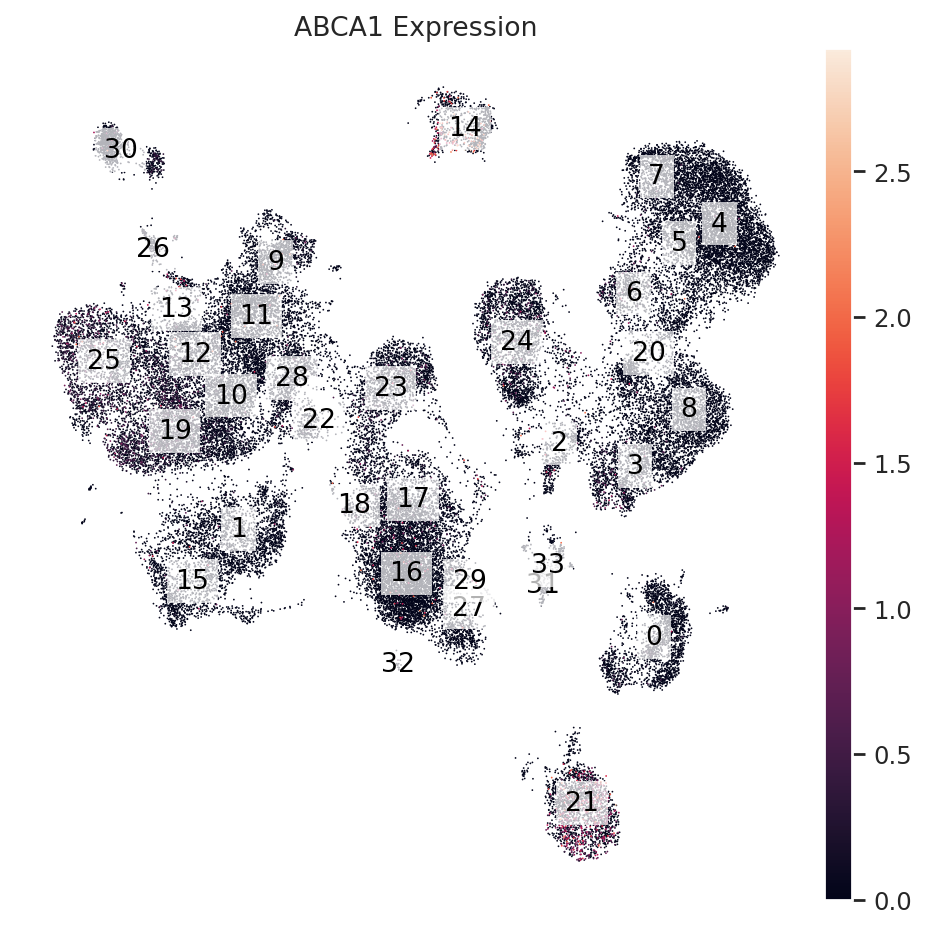

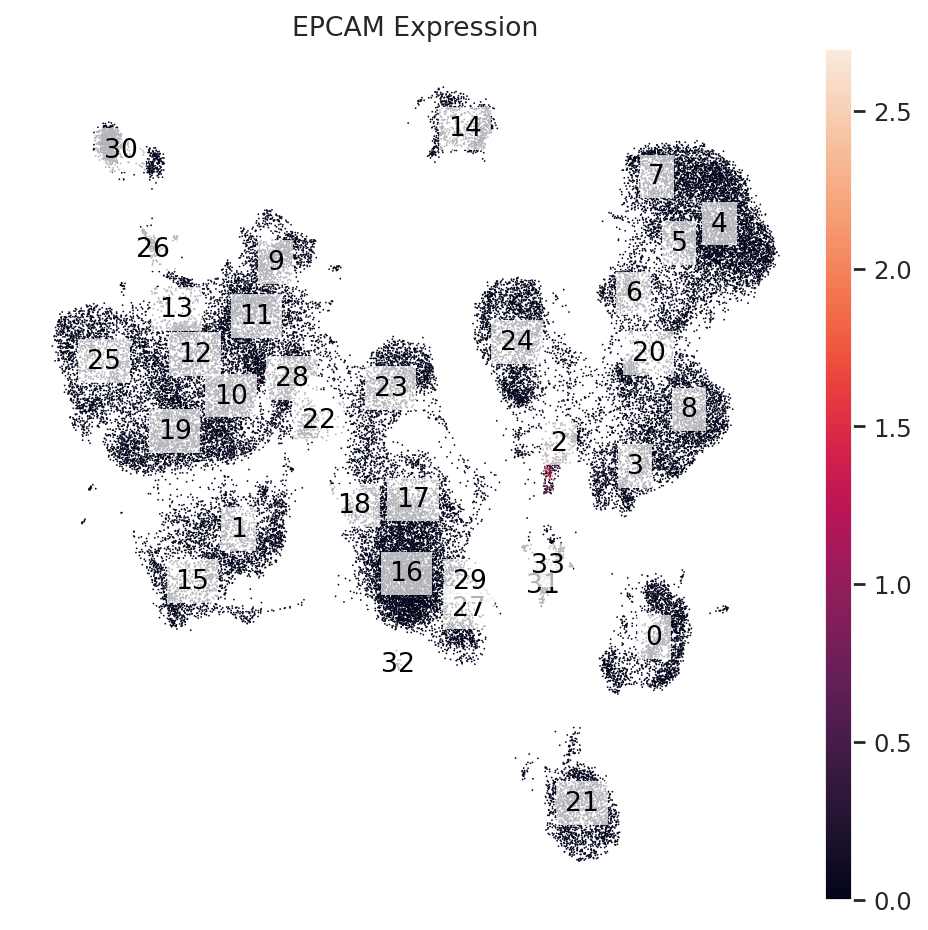

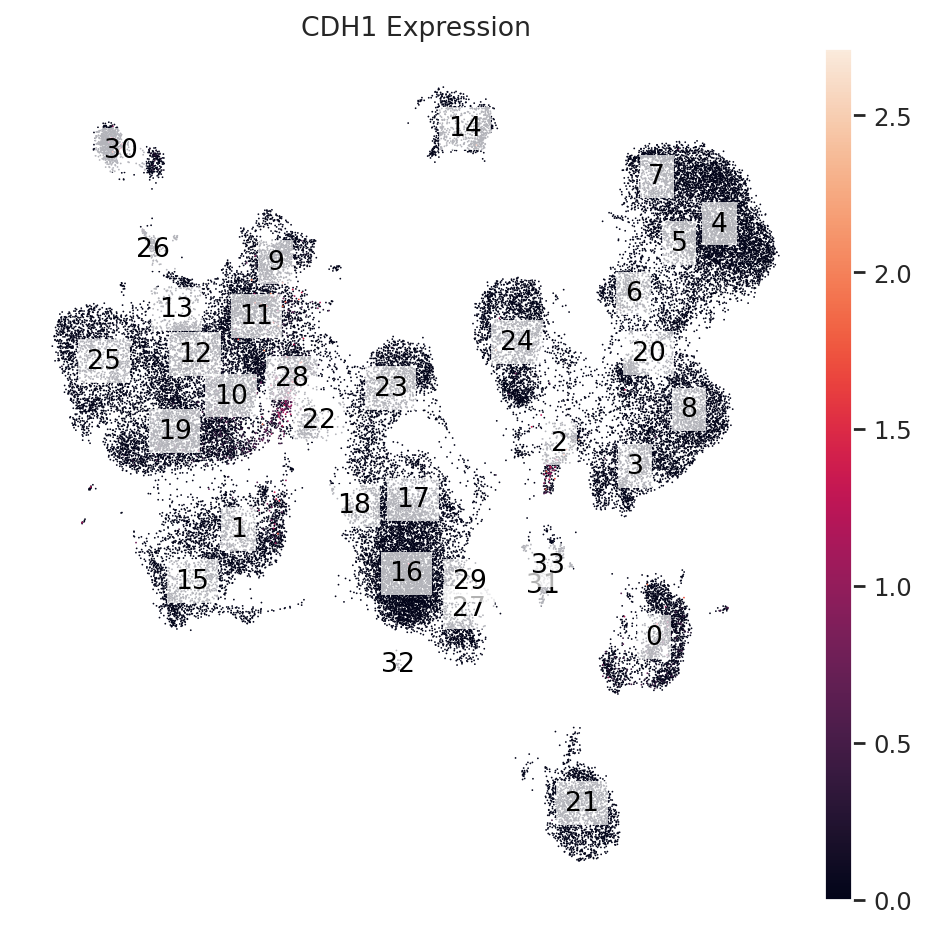

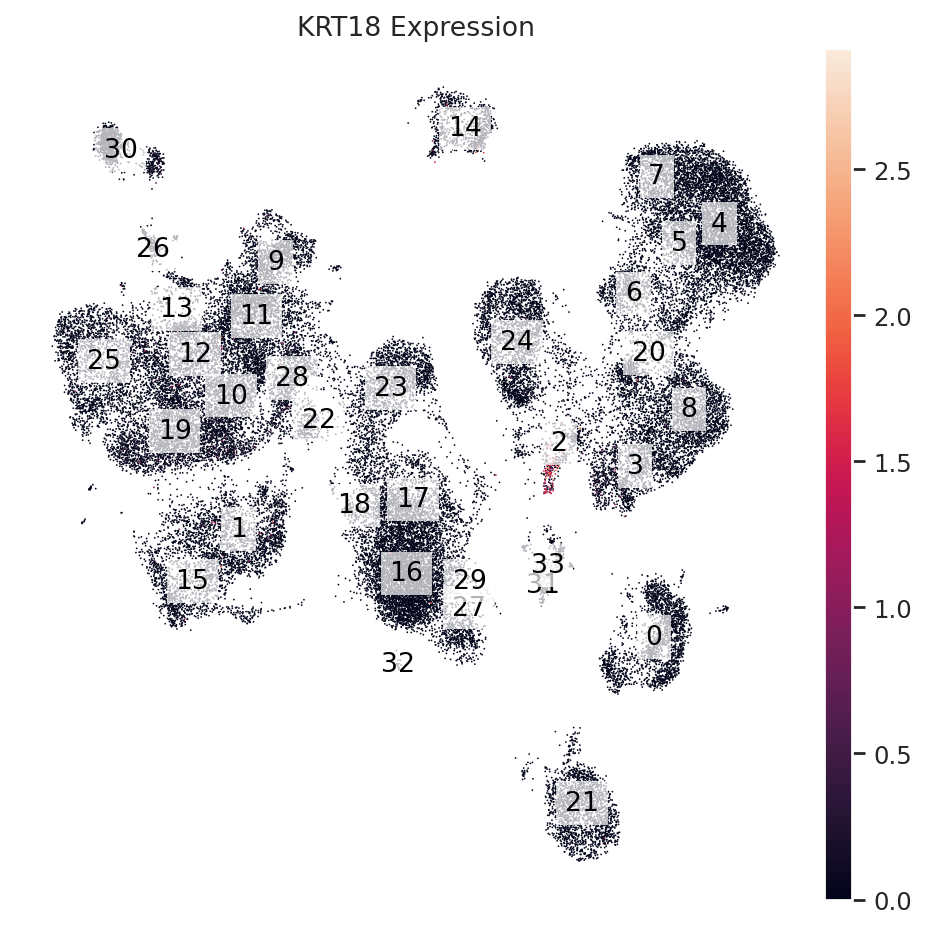

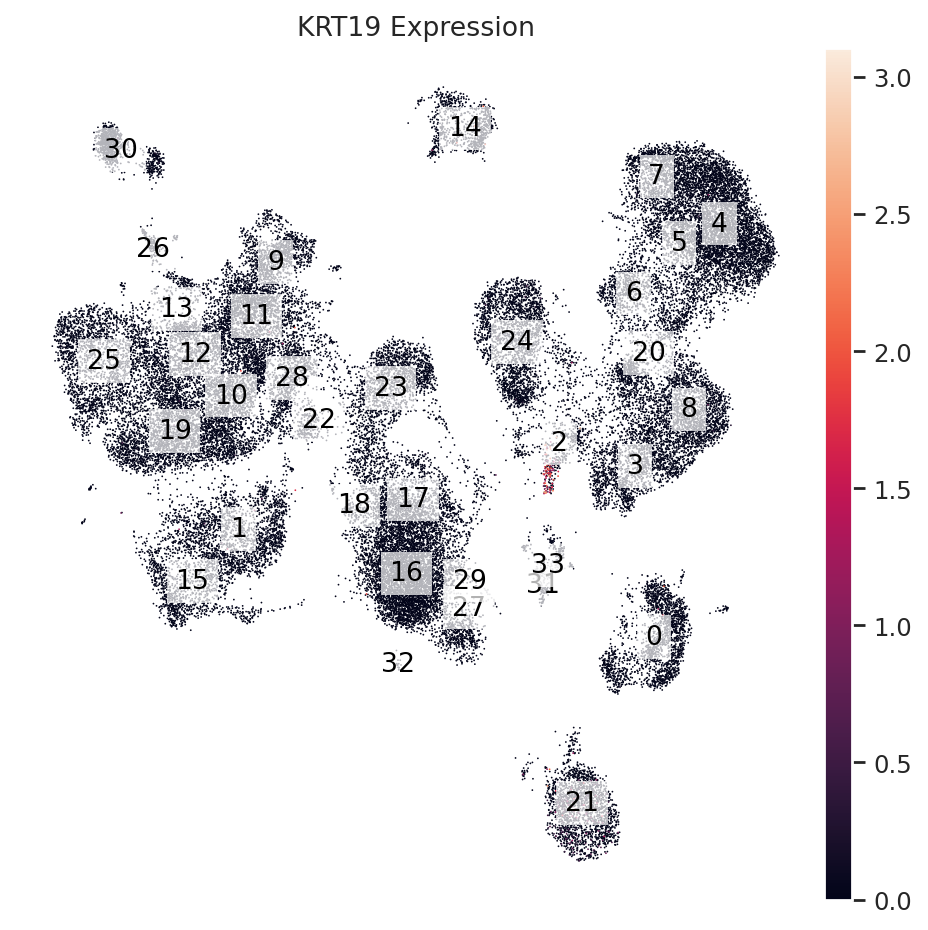

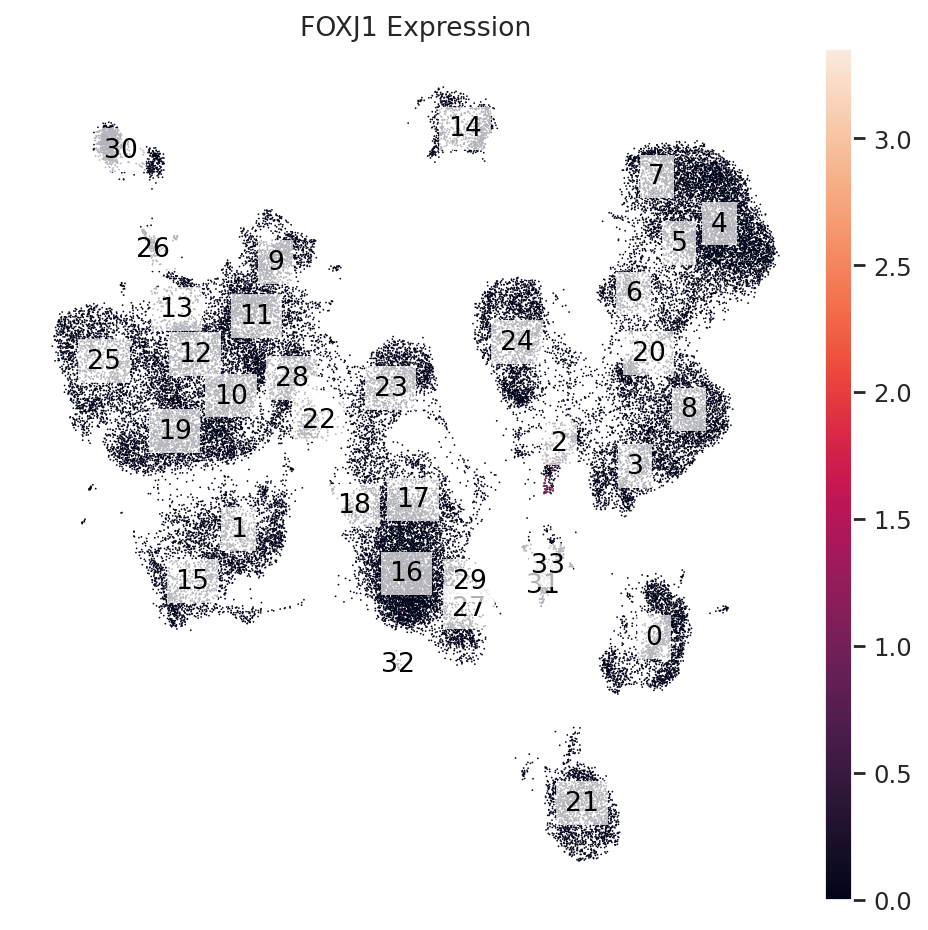

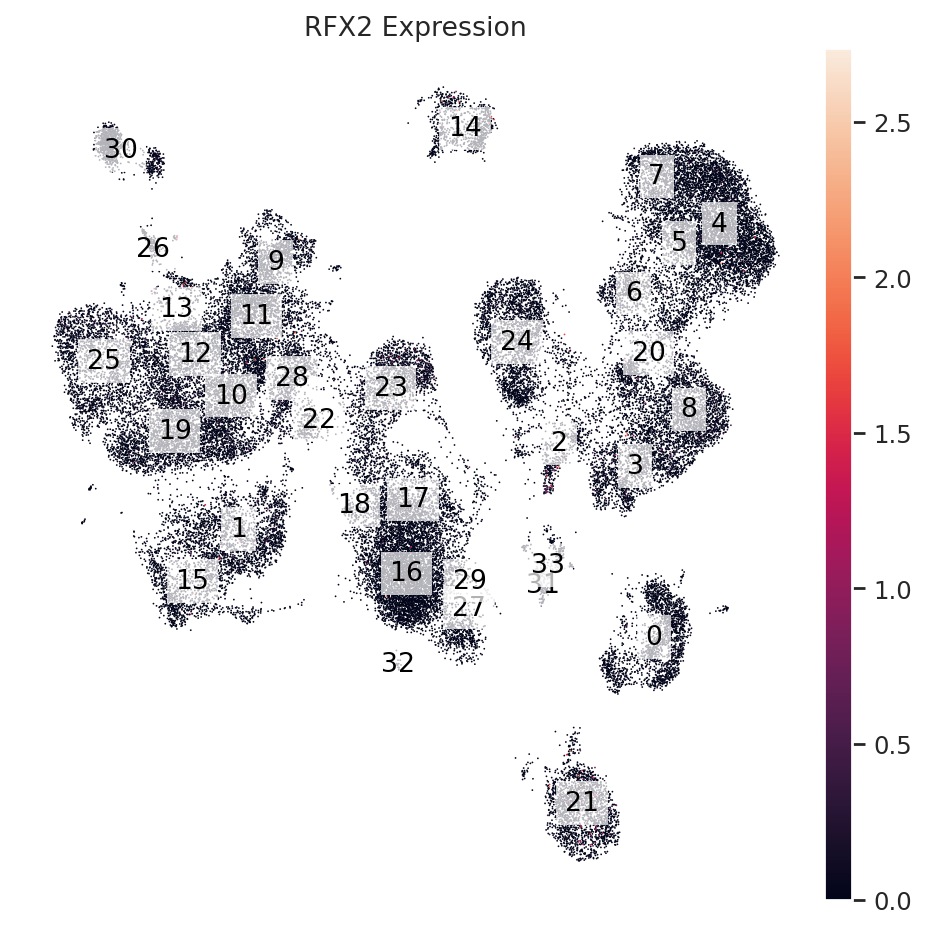

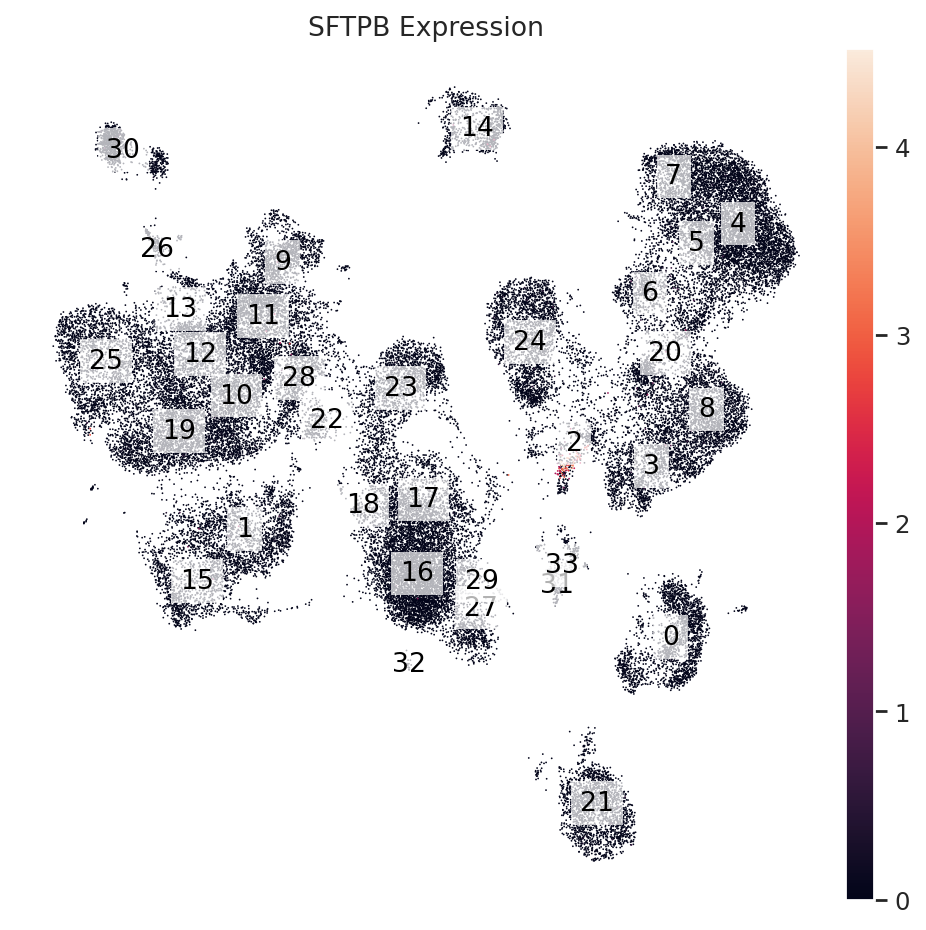

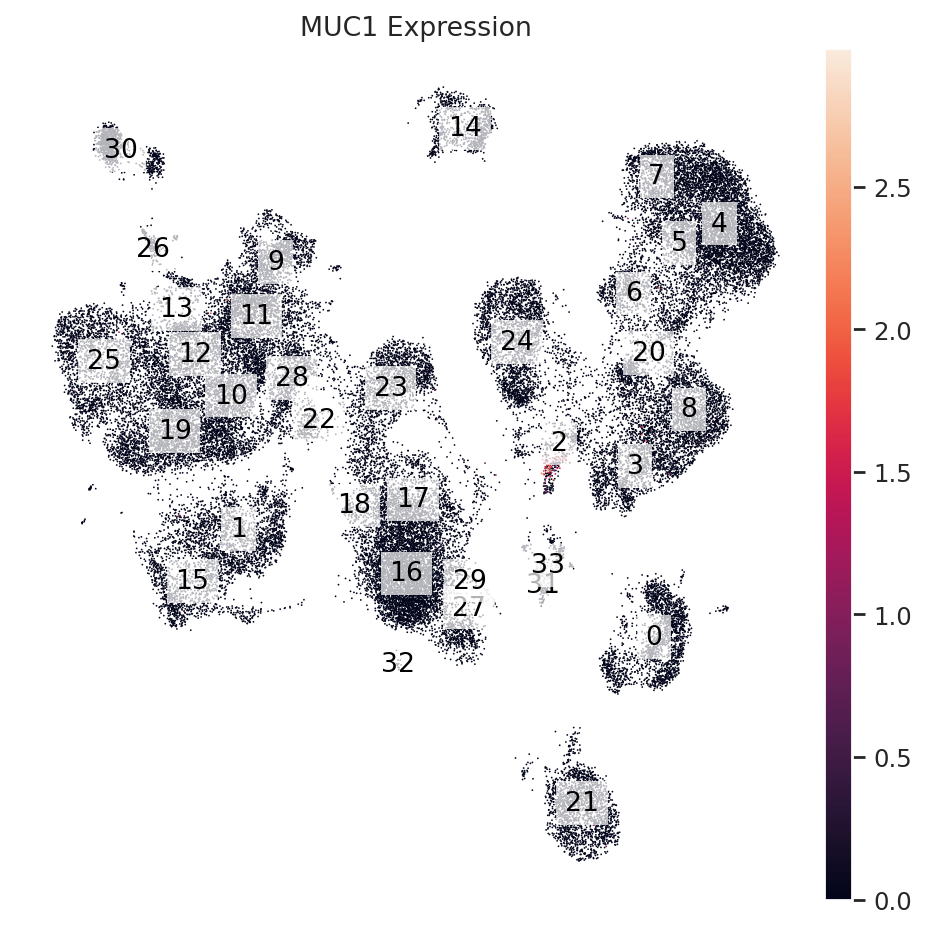

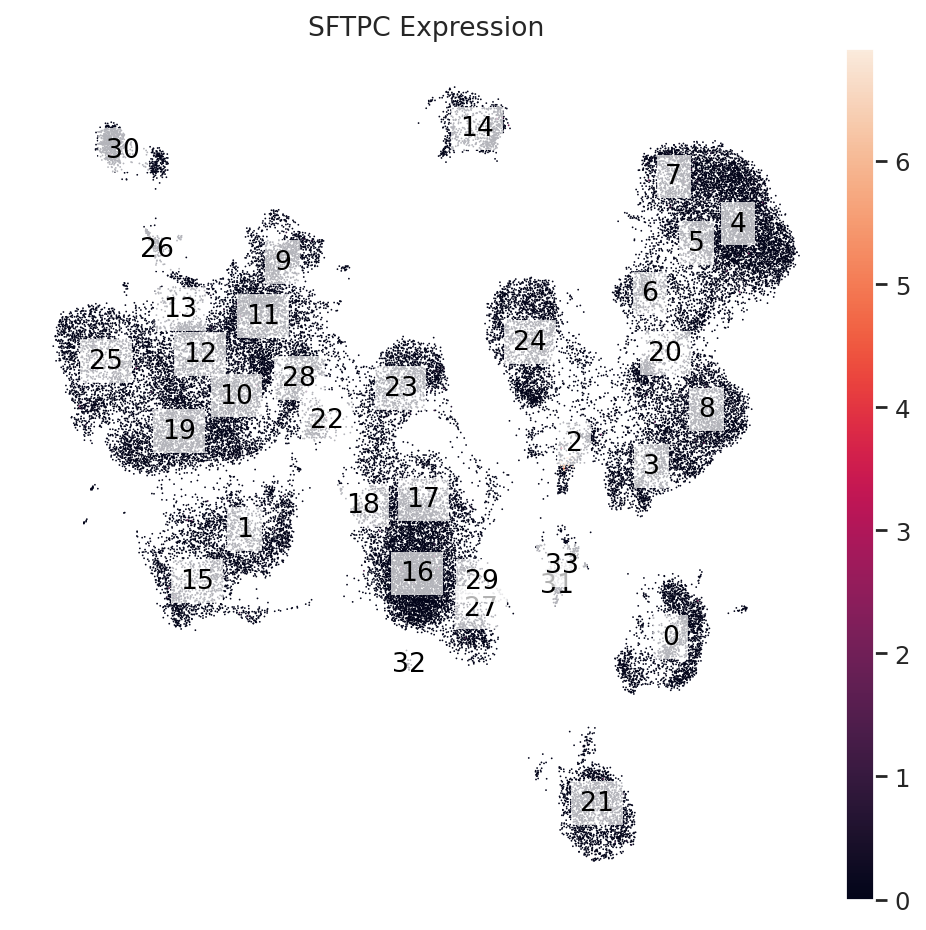

In [7]:
genes = ["ABCA1", "EPCAM", "CDH1", "KRT18", "KRT19", "FOXJ1", "RFX2", "SFTPB", "MUC1","SFTPC"]
#[adata_filtered.obs['leiden'].isin(["25"])]

for gene in genes:
    sc.pl.umap(
        adata_filtered, #[adata_filtered.obs['leiden'].isin(["2"])],
        color=gene,
        title=f"{gene} Expression",
        show=False
    )

    umap_coords = adata_filtered.obsm["X_umap"]
    clusters = adata_filtered.obs["leiden"]
    cluster_subset = clusters#[clusters.isin(["2"])]
    cluster_centers = np.array([
        umap_coords[clusters == cluster].mean(axis=0)
        for cluster in sorted(cluster_subset.unique())
    ])

    fig = plt.gcf()
    ax = plt.gca()
    for cluster, (x, y) in zip(sorted(cluster_subset.unique()), cluster_centers):
        ax.text(
            x, y, str(cluster),
            color="black",
            fontsize=12,
            ha="center",
            va="center",
            bbox=dict(facecolor="white", alpha=0.7, edgecolor="none")
        )

    plt.tight_layout()
    plt.show()
    plt.close(fig)

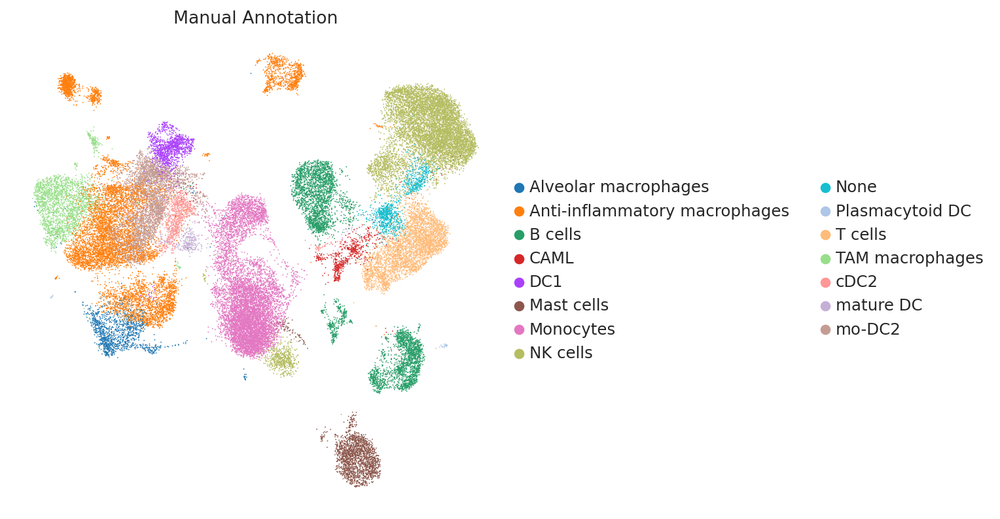

In [14]:
merging_dict = {
    "0": "B cells",
    "1": "Anti-inflammatory macrophages",
    "2": "CAML",
    "3": "T cells",
    "4": "NK cells",
    "5": "NK cells",
    "6": "NK cells",
    "7": "NK cells",
    "8": "T cells",
    "9": "DC1",
    "10": "mo-DC2",
    "11": "mo-DC2",
    "12": "Anti-inflammatory macrophages",
    "13": "Anti-inflammatory macrophages",
    "14": "Anti-inflammatory macrophages",
    "15": "Alveolar macrophages",
    "16": "Monocytes",
    "17": "Monocytes",
    "18": "Monocytes",
    "19": "Anti-inflammatory macrophages",
    "20": "None",
    "21": "Mast cells",
    "22": "mature DC",
    "23": "Monocytes",
    "24": "B cells",
    "25": "TAM macrophages",
    "26": "TAM macrophages",
    "27": "NK cells",
    "28": "cDC2",
    "29": "Mast cells",
    "30": "Anti-inflammatory macrophages",
    "31": "Plasmacytoid DC",
    "32": "Alveolar macrophages",
    "33": "B cells"
}



adata_filtered.obs["manual_annotation"] = adata_filtered.obs["leiden"].map(merging_dict)

sc.pl.umap(adata_filtered, color="manual_annotation", title = "Manual Annotation")

categories: Alveolar macrophages, Anti-inflammatory macrophages, B cells, etc.
var_group_labels: 0, 1, 2, etc.


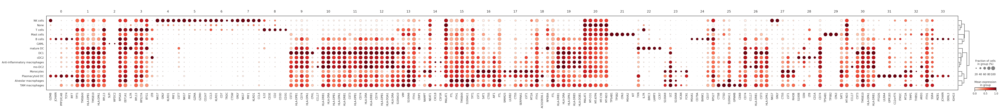

In [15]:
sc.pl.rank_genes_groups_dotplot(
    adata_filtered,
    groupby="manual_annotation",
    standard_scale="var",
    n_genes=5,
    key="rank_genes_groups_leiden",
    #gene_symbols="gene_names"
    )

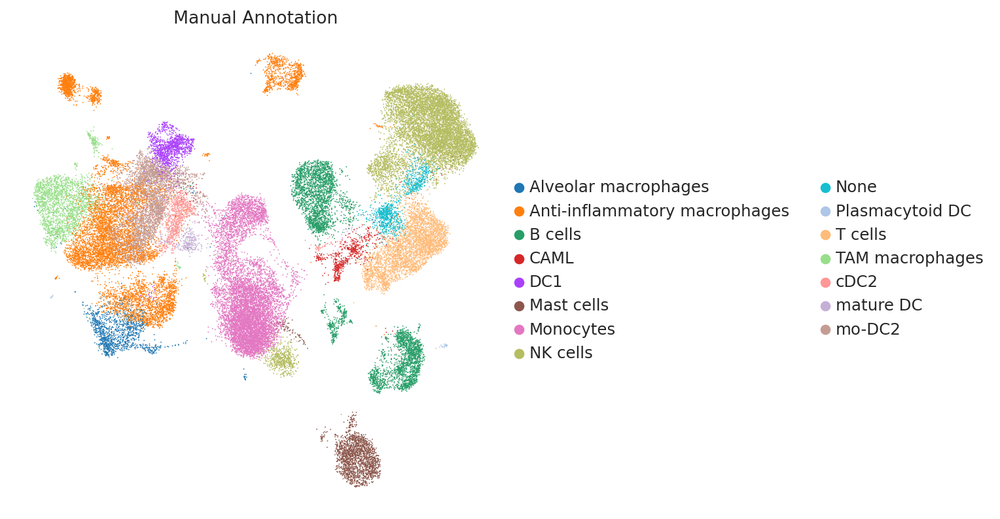

<Figure size 480x480 with 0 Axes>

In [16]:
output_path = os.path.join(graphics_path, "Annotation", "Manual_annotation.pdf")

with PdfPages(output_path) as pdf:
    fig, ax = plt.subplots()

    sc.pl.umap(adata_filtered, 
        color="manual_annotation", 
        title="Manual Annotation", 
        ax=ax, 
        show=True)
    
    plt.tight_layout()
    pdf.savefig(fig)
    plt.close(fig)

In [18]:
del adata_filtered.uns["rank_genes_groups_leiden_filtered"]
adata_filtered.write(os.path.join(data_path, "adata_annotated_full.h5ad"))

In [ ]:
adata_filtered = sc.read(os.path.join(data_path, "adata_annotated_full.h5ad"))

/tmp/ipykernel_7547/3132853425.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_counts = tumor_cells.groupby(["Patient", "manual_annotation"]).size().unstack(fill_value=0)


<Figure size 800x640 with 0 Axes>

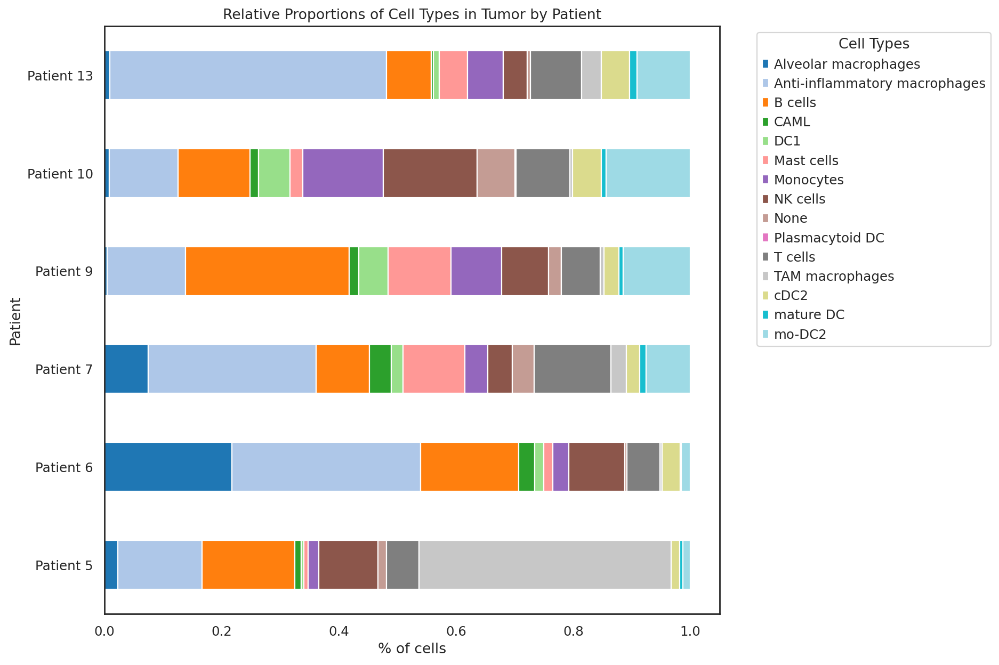

In [17]:
# Calculate proportions of clusters per patient

tumor_cells = adata_filtered.obs[adata_filtered.obs["Sampling site"] == "tumor"]
cell_type_counts = tumor_cells.groupby(["Patient", "manual_annotation"]).size().unstack(fill_value=0)

cell_type_proportions = cell_type_counts.div(cell_type_counts.sum(axis=1), axis=0)

plt.figure(figsize=(10, 8))
cell_type_proportions.plot(kind="barh", stacked=True, figsize=(12, 8), cmap="tab20")

plt.xlabel("% of cells")
plt.ylabel("Patient")
plt.title("Relative Proportions of Cell Types in Tumor by Patient")
plt.legend(title="Cell Types", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()
